In [1]:
import pickle
import numpy as np
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import accuracy_score,confusion_matrix,roc_auc_score,roc_curve
from sklearn.linear_model import RidgeCV,LassoCV,ElasticNetCV,Ridge,Lasso,ElasticNet,LogisticRegression


In [2]:
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/diabetes.csv")

In [3]:
df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [6]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
df['BMI'] = df['BMI'].replace(0,df['BMI'].mean())

In [14]:
df['Glucose'] = df['Glucose'].replace(0,df['Glucose'].mean())

In [11]:
df['Insulin'] = df['Insulin'].replace(0,df['Insulin'].mean())

In [10]:
df['BloodPressure'] = df['BloodPressure'].replace(0,df['BloodPressure'].mean())

In [13]:
df['SkinThickness'] = df['SkinThickness'].replace(0,df['SkinThickness'].mean())

In [15]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<AxesSubplot:>

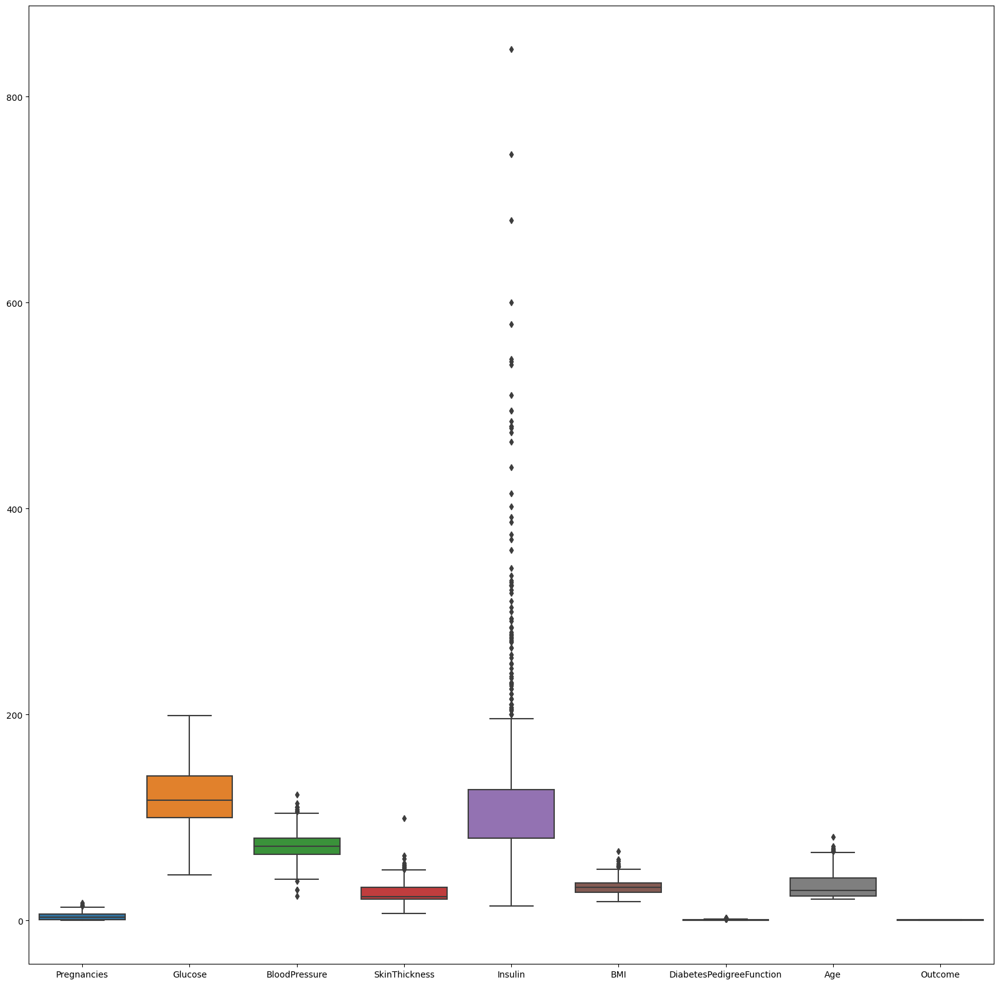

In [25]:
fig , ax = plt.subplots(figsize = (20,20))
sns.boxplot(data=df , ax = ax)

In [33]:
q = df['Insulin'].quantile(0.90)
df1 = df[df['Insulin'] <q]

In [34]:
df1

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


<AxesSubplot:>

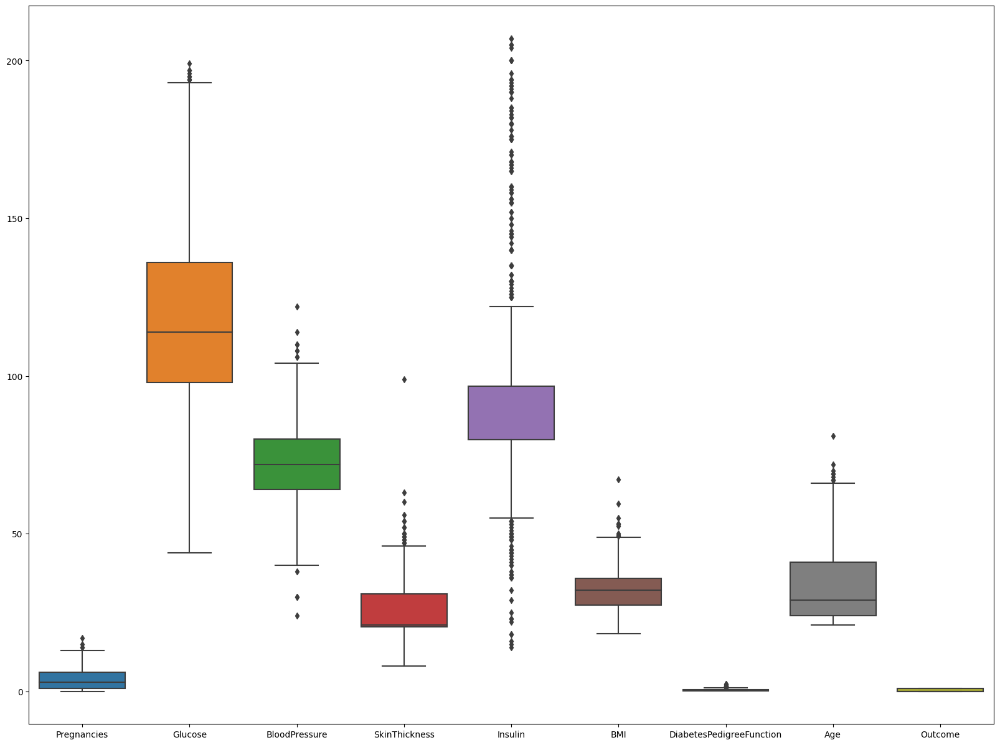

In [35]:
fig , ax = plt.subplots(figsize = (20,15))
sns.boxplot(data=df1 , ax = ax)

In [53]:
q = df['Pregnancies'].quantile(0.98)
df1 = df[df['Pregnancies'] <q]

q = df1['BMI'].quantile(0.99)
df1 = df1[df1['BMI']<q]

q = df1['SkinThickness'].quantile(0.99)
df1 = df1[df1['SkinThickness']<q]

q = df1['Insulin'].quantile(0.95)
df1 = df1[df1['Insulin']<q]

q = df1['DiabetesPedigreeFunction'].quantile(0.99)
df1 = df1[df1['DiabetesPedigreeFunction']<q]

q = df1['Age'].quantile(0.99)
df1 = df1[df1['Age']<q]


In [ ]:
def remove_outlier(self , df) : 
    
    def outlier_limit(col) :
        Q3 , Q1 = np.nanpercentile(col , [75,25])
        IQR = Q3 - Q1
        UL = Q3 + 1.5*IQR
        LL = Q1 - 1.5*IQR
        return UL , LL
    
    for column in df.columns :
        if df[column].type!= 'int64' :
            UL , LL  = outlier_limit(df[column])
            df[column] = np.where((df[column] > UL) | (df[column] < LL) , np.nan , df[column])
    
    return df   
remove_outlier(df)     

In [54]:
df1

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30,0
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


<AxesSubplot:>

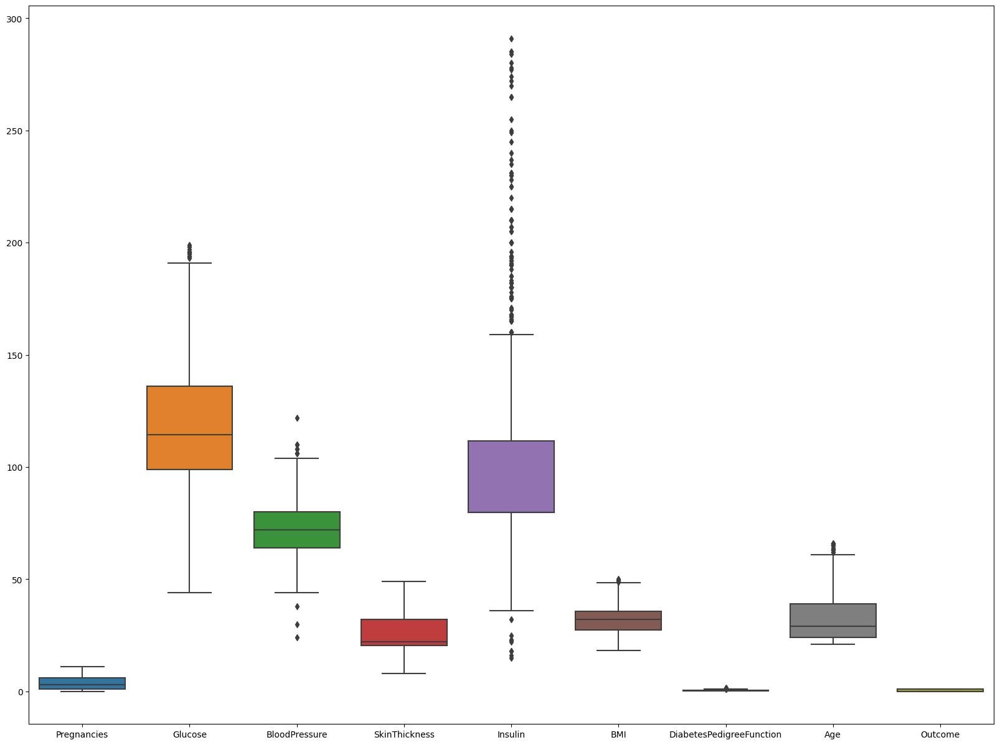

In [55]:
fig , ax = plt.subplots(figsize = (20,15))
sns.boxplot(data=df1 , ax = ax)

In [60]:
df1

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30,0
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


In [61]:
y = df1['Outcome']
y

0      1
1      0
2      1
3      0
5      0
      ..
763    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 674, dtype: int64

In [62]:
X = df1.drop(columns='Outcome')
X


,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30
...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47


In [67]:
scaler = StandardScaler()
ProfileReport(pd.DataFrame(scaler.fit_transform(df1)))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<AxesSubplot:>

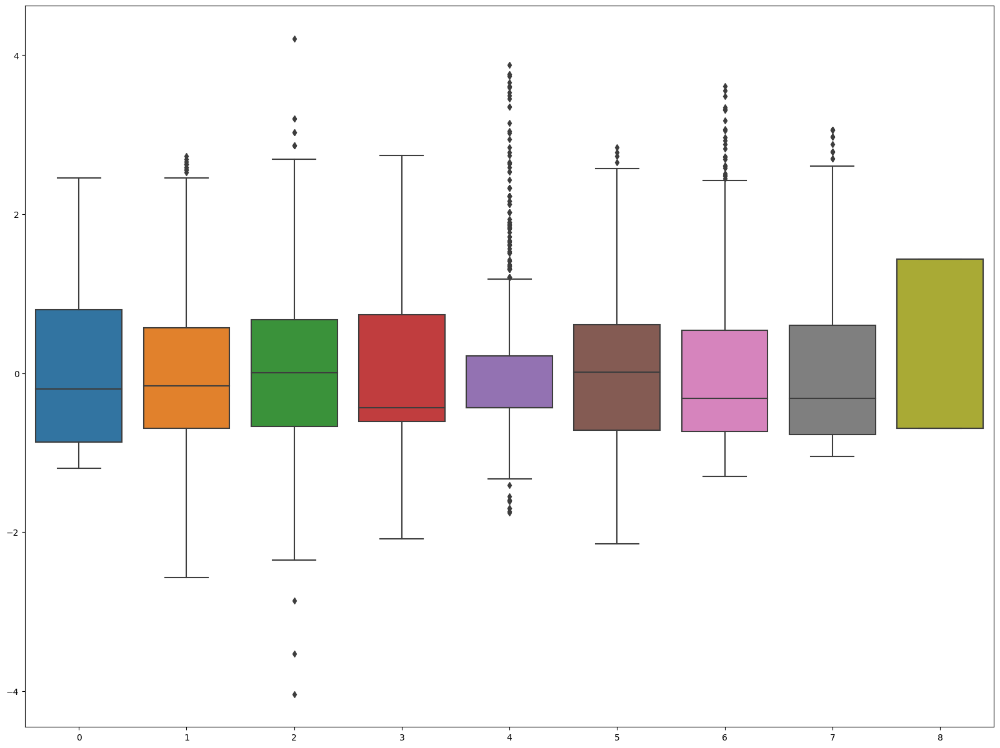

In [69]:
df1_scaler = pd.DataFrame(scaler.fit_transform(df1))
fig , ax = plt.subplots(figsize = (20,15))
sns.boxplot(data= pd.DataFrame(scaler.fit_transform(df1)), ax = ax)

In [71]:
X_scale = scaler.fit_transform(df1)
X_scale

array([[ 7.96753910e-01,  9.83984062e-01,  4.52611463e-04, ...,
         6.30484542e-01,  1.60141519e+00,  1.43170310e+00],
       [-8.64793539e-01, -1.16977621e+00, -5.04474494e-01, ...,
        -3.38078670e-01, -1.32706484e-01, -6.98468839e-01],
       [ 1.46137289e+00,  2.18051755e+00, -6.72783529e-01, ...,
         7.88402456e-01, -4.14369227e-02,  1.43170310e+00],
       ...,
       [ 4.64444420e-01,  6.09439465e-02,  4.52611463e-04, ...,
        -7.10063091e-01, -2.23976046e-01, -6.98468839e-01],
       [-8.64793539e-01,  2.31877301e-01, -1.00940160e+00, ...,
        -3.45097244e-01,  1.32760650e+00,  1.43170310e+00],
       [-8.64793539e-01, -8.96282840e-01, -1.67856424e-01, ...,
        -4.64413001e-01, -8.62862978e-01, -6.98468839e-01]])

In [72]:
y

0      1
1      0
2      1
3      0
5      0
      ..
763    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 674, dtype: int64

In [73]:
def vif_score(x) : 
    scaler = StandardScaler()
    arr = scaler.fit_transform(x)
    return  pd.DataFrame([[x.columns[i] ,variance_inflation_factor(arr , i)] for i in range (arr.shape[1])], columns= ['Feature','VIF_SCORE'])

In [74]:
vif_score(X)

,Feature,VIF_SCORE
0,Pregnancies,1.449056
1,Glucose,1.304263
2,BloodPressure,1.262686
3,SkinThickness,1.470049
4,Insulin,1.271017
5,BMI,1.513160
6,DiabetesPedigreeFunction,1.042300
7,Age,1.662728


In [75]:
x_train , x_test , y_train , y_test = train_test_split(X_scale,y,test_size=0.20,random_state=144)

In [76]:
x_train


array([[-0.86479354,  0.19769063, -1.85094678, ...,  1.80609569,
        -0.40651517,  1.4317031 ],
       [ 2.45830136,  1.22329076,  0.33707068, ...,  3.1782269 ,
         1.69268475,  1.4317031 ],
       [ 0.13213493,  0.91561072,  1.09446134, ..., -0.90658316,
        -0.49778473, -0.69846884],
       ...,
       [-0.86479354, -0.28092276,  1.17861586, ..., -1.06801036,
        -0.86286298, -0.69846884],
       [ 1.46137289,  0.02675728,  0.50537972, ..., -0.13454002,
         2.87918905, -0.69846884],
       [-0.86479354, -0.75953616, -0.33616546, ...,  2.27283086,
        -0.95413254, -0.69846884]])

In [77]:
x_test

array([[ 1.32134931e-01, -1.44176079e-01,  4.52611463e-04, ...,
        -2.50346495e-01,  1.23633694e+00,  1.43170310e+00],
       [-1.19710303e+00,  6.76304024e-01, -8.41092564e-01, ...,
        -8.43415997e-01, -1.04540210e+00, -6.98468839e-01],
       [ 2.45830136e+00,  8.13050708e-01,  1.85185200e+00, ...,
        -6.78479508e-01,  1.69268475e+00,  1.43170310e+00],
       ...,
       [ 7.96753910e-01, -5.54416131e-01, -5.04474494e-01, ...,
        -6.96025943e-01, -3.15245608e-01, -6.98468839e-01],
       [-5.32484049e-01, -1.20396288e+00, -2.43135269e-01, ...,
        -5.03015158e-01, -1.04540210e+00, -6.98468839e-01],
       [-8.64793539e-01, -1.64838960e+00, -2.01925581e+00, ...,
        -4.36338705e-01, -9.54132539e-01, -6.98468839e-01]])

In [111]:
logrliblinear = LogisticRegression(verbose=1,solver='liblinear')

In [112]:
logrliblinear.fit(x_train,y_train)

[LibLinear]

LogisticRegression(solver='liblinear', verbose=1)

In [113]:
for i in range(len(x_test[0])) : 
    print(logrliblinear.predict([x_test[i]]))

[1]
[0]
[1]
[0]
[1]
[0]
[0]
[0]
[0]


In [105]:
y_test

406    1
511    0
24     1
751    0
689    1
      ..
3      0
469    0
587    0
60     0
97     0
Name: Outcome, Length: 135, dtype: int64

In [116]:
logrliblinear.score(x_test,y_test)

1.0

In [115]:
y_predict_liblinear = logrliblinear.predict(x_test)
y_predict_liblinear

array([1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0,
       0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1,
       1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0,
       0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0,
       1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0], dtype=int64)

In [117]:
logr = LogisticRegression(verbose=1)
logr.fit(x_train,y_train)
y_predict_default = logr.predict(x_test)
y_predict_default

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


array([1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0,
       0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1,
       1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0,
       0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0,
       1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0], dtype=int64)

In [118]:
confusion_matrix(y_test,y_predict_liblinear)

array([[87,  0],
       [ 0, 48]], dtype=int64)

In [119]:
confusion_matrix(y_test,y_predict_default)

array([[87,  0],
       [ 0, 48]], dtype=int64)

In [121]:
def model_eval(y_true,y_pred):
    tn, fp, fn, tp = confusion_matrix(y_test,y_pred).ravel()
    accuracy=(tp+tn)/(tp+tn+fp+fn)
    precision=tp/(tp+fp)
    recall=tp/(tp+fn)
    specificity=tn/(fp+tn)
    F1_Score = 2*(recall * precision) / (recall + precision)
    result={"Accuracy":accuracy,"Precision":precision,"Recall":recall,'Specficity':specificity,'F1':F1_Score}
    return result
model_eval(y_test,y_predict_liblinear)


{'Accuracy': 1.0,
 'Precision': 1.0,
 'Recall': 1.0,
 'Specficity': 1.0,
 'F1': 1.0}

In [122]:
model_eval(y_test,y_predict_default)

{'Accuracy': 1.0,
 'Precision': 1.0,
 'Recall': 1.0,
 'Specficity': 1.0,
 'F1': 1.0}

In [131]:
auc = roc_auc_score(y_test,y_predict_liblinear)

In [132]:
roc_auc_score(y_test,y_predict_default)

1.0

In [133]:
fpr, tpr, thresholds  = roc_curve(y_test,y_predict_liblinear)

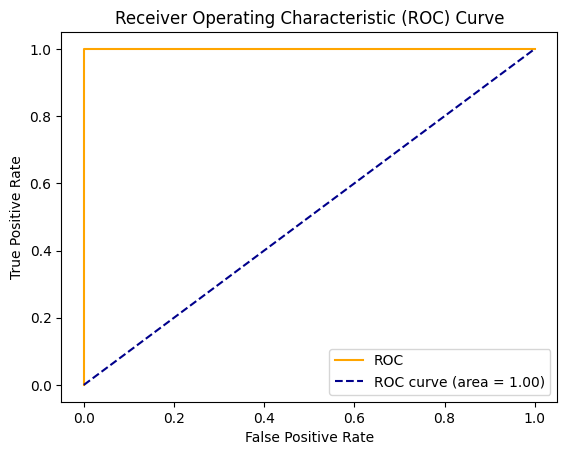

In [134]:
plt.plot(fpr, tpr, color='orange', label='ROC')
plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--',label='ROC curve (area = %0.2f)' % auc)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()